## Istanbul Airbnb Data Dec, 2020


### Table of Contents

1. Data & Business Understanding

2. Data Preparation

3. Data Analyses - Answering the Questions

4. Evaluation - Findings 

## 1. Data & Business Understanding

#### Context
Airbnb, Inc. is an American vacation rental online marketplace company based in San Francisco, California. Airbnb maintains and hosts a marketplace, accessible to consumers on its website or via an app.The dataset analyzed in here describes the listing activity and metrics in Istanbul, Turkey scraped at Dec, 2020.

#### Content
This data file includes summary metrics about listings which are available on the date Dec, 2020.


#### Data Exploration
In this project, we will examine data and answer the questions below, explore further areas with deeper analysis.

1.In which districts shared houses are popular? 
  In which districts hotels are more common in listings?
  In which districts shared houses are unpopular? 
  
2.What are the top districts for review value score?

3.What are the price differences for districts? Is price range distribution different for top 5 districts? Is the difference statistically significant?

4.Does continent  makes a difference at daily price value?

5.Does price affected by distance to touristic areas?

## 2. Data Preparation

In [76]:
import pandas as pd
import numpy as np
import folium
from folium.plugins import HeatMap
import matplotlib.pyplot as plt
import seaborn as sns
sns.set(style = 'white')
from scipy.stats import norm
from geopy.distance import geodesic
import branca.colormap as cm

We first read the datasets with pandas read_csv method.

Data has 15 columns as shown below with the detailed descriptions. We have features like unique features (id, name), host information(host id, host_name), environment details (neighbourhod group and itself, latitude, longtitude) , room type, price and etc. 


1. id - listing ID
2. name - name of the listing on Airbnb website
3. host_id - ID of the host
4. host_name - name of the host
5. neighbourhood_group - main grouped districts
6. neighbourhood - district names
7. latitude - latitude coordinates
8. longitude - longitude coordinates
9. room_type - listing space type
10. price - listing's price
11. number_of_reviews - total number of reviews the listing has recieved
12. last_review - date of the last review received
13. reviews_per_month - number of reviews received by the listing per month
14. calculated_host_listings_count - amount of listings per host
15. availability_365 - number of days when listing is available for booking

In [77]:
ist = pd.read_csv('airbnb_istanbul.csv')
ist.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,20815,The Bosphorus from The Comfy Hill,78838,Gülder,NaN,Besiktas,41.06984,29.04545,Entire home/apt,891,365,41,2018-11-07,0.31,2,363
1,27271,Lovely apartment in perfect location,117026,Mutlu,NaN,Beyoglu,41.03254,28.98153,Entire home/apt,273,30,10,2018-05-04,0.30,1,0
2,28318,Cosy home overlooking Bosphorus,121721,Aydin,NaN,Sariyer,41.09048,29.05559,Entire home/apt,930,3,0,NaN,NaN,1,88
3,29241,"↪ Istanbul, Your second house",125742,Şevki,NaN,Beyoglu,41.04844,28.95254,Private room,372,3,0,NaN,NaN,1,0
4,30697,nice home in popular area,132137,Nan,NaN,Beyoglu,41.03350,28.97626,Private room,908,1,1,2010-06-14,0.01,1,365


In [78]:
ist.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23650 entries, 0 to 23649
Data columns (total 16 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              23650 non-null  int64  
 1   name                            23616 non-null  object 
 2   host_id                         23650 non-null  int64  
 3   host_name                       23642 non-null  object 
 4   neighbourhood_group             0 non-null      float64
 5   neighbourhood                   23650 non-null  object 
 6   latitude                        23650 non-null  float64
 7   longitude                       23650 non-null  float64
 8   room_type                       23650 non-null  object 
 9   price                           23650 non-null  int64  
 10  minimum_nights                  23650 non-null  int64  
 11  number_of_reviews               23650 non-null  int64  
 12  last_review                     

In [79]:
ist.duplicated().sum()

0

In [80]:
ist.drop_duplicates(subset=['id'], inplace=True)

Drop the duplicates if there is.

In [81]:
ist.isnull().sum()

id                                    0
name                                 34
host_id                               0
host_name                             8
neighbourhood_group               23650
neighbourhood                         0
latitude                              0
longitude                             0
room_type                             0
price                                 0
minimum_nights                        0
number_of_reviews                     0
last_review                       12313
reviews_per_month                 12313
calculated_host_listings_count        0
availability_365                      0
dtype: int64

There are some missing data problems in the neighbourhood group , last review, reviews per month and the name columns.

We can drop name column easily. We have id and other needed informations, it is enough for analysis since we do not seek any NLP analysis on name information.

Neighbourhood group may be beneficial if there is but in the lack of this knowledge we may explore data with neighbourhood feature.We will drop "neighbourhood group" feature.

Last review and reviews per month features has a lot of missing values. We will not make any deeper analysis for this features,we can drop.

In [82]:
ist = ist.drop(['name', 'host_name', "neighbourhood_group",'last_review',"reviews_per_month"], axis = 1)

There is another dataset which contains more detailed features for listings. We load this data as "ist_detailed" and merge it with original datarame. We will use only needed features from "ist_detailed" data and use left join.

In [83]:
ist_detailed = pd.read_csv('airbnb_istanbul_detailed.csv')
print(ist_detailed.shape)
ist_detailed.head()

(23650, 74)


,id,listing_url,scrape_id,last_scraped,name,description,neighborhood_overview,picture_url,host_id,host_url,...,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,20815,https://www.airbnb.com/rooms/20815,20201231072304,2021-01-04,The Bosphorus from The Comfy Hill,Watch The Bosphorus from The Comfy Hill.<br />...,"The lovely neighborhood, Arnavutkoy, is locate...",https://a0.muscache.com/pictures/94805791/481d...,78838,https://www.airbnb.com/users/show/78838,...,10.0,10.0,9.0,NaN,f,2,1,1,0,0.31
1,27271,https://www.airbnb.com/rooms/27271,20201231072304,2021-01-06,Lovely apartment in perfect location,This is a nicely decorated apartment in an an...,Cihangir is one of Istanbul's cosmopolitan sub...,https://a0.muscache.com/pictures/2f9cfc85-8370...,117026,https://www.airbnb.com/users/show/117026,...,10.0,10.0,10.0,NaN,f,1,1,0,0,0.30
2,28318,https://www.airbnb.com/rooms/28318,20201231072304,2021-01-02,Cosy home overlooking Bosphorus,<b>The space</b><br />Easy access to both brid...,Close to Bosphorus University<br />Close to Be...,https://a0.muscache.com/pictures/76617600/0ab5...,121721,https://www.airbnb.com/users/show/121721,...,NaN,NaN,NaN,NaN,f,1,1,0,0,NaN
3,29241,https://www.airbnb.com/rooms/29241,20201231072304,2021-01-04,"↪ Istanbul, Your second house",<b>The space</b><br />There are many interesti...,NaN,https://a0.muscache.com/pictures/12385994/b9ba...,125742,https://www.airbnb.com/users/show/125742,...,NaN,NaN,NaN,NaN,f,1,0,1,0,NaN
4,30697,https://www.airbnb.com/rooms/30697,20201231072304,2021-01-03,nice home in popular area,<b>The space</b><br />I can ensure you that th...,NaN,https://a0.muscache.com/pictures/6392807/b6f01...,132137,https://www.airbnb.com/users/show/132137,...,NaN,NaN,NaN,NaN,f,1,0,1,0,0.01


In [84]:
ist_detailed.columns

Index(['id', 'listing_url', 'scrape_id', 'last_scraped', 'name', 'description',
       'neighborhood_overview', 'picture_url', 'host_id', 'host_url',
       'host_name', 'host_since', 'host_location', 'host_about',
       'host_response_time', 'host_response_rate', 'host_acceptance_rate',
       'host_is_superhost', 'host_thumbnail_url', 'host_picture_url',
       'host_neighbourhood', 'host_listings_count',
       'host_total_listings_count', 'host_verifications',
       'host_has_profile_pic', 'host_identity_verified', 'neighbourhood',
       'neighbourhood_cleansed', 'neighbourhood_group_cleansed', 'latitude',
       'longitude', 'property_type', 'room_type', 'accommodates', 'bathrooms',
       'bathrooms_text', 'bedrooms', 'beds', 'amenities', 'price',
       'minimum_nights', 'maximum_nights', 'minimum_minimum_nights',
       'maximum_minimum_nights', 'minimum_maximum_nights',
       'maximum_maximum_nights', 'minimum_nights_avg_ntm',
       'maximum_nights_avg_ntm', 'calendar_upd

In [85]:
ist = ist.merge(ist_detailed[["id","description",'review_scores_rating', 'review_scores_accuracy',
       'review_scores_cleanliness', 'review_scores_checkin',
       'review_scores_communication', 'review_scores_location',
       'review_scores_value']],on="id",how="left")
ist.head()

,id,host_id,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,calculated_host_listings_count,availability_365,description,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value
0,20815,78838,Besiktas,41.06984,29.04545,Entire home/apt,891,365,41,2,363,Watch The Bosphorus from The Comfy Hill.<br />...,90.0,9.0,9.0,10.0,10.0,10.0,9.0
1,27271,117026,Beyoglu,41.03254,28.98153,Entire home/apt,273,30,10,1,0,This is a nicely decorated apartment in an an...,98.0,10.0,9.0,10.0,10.0,10.0,10.0
2,28318,121721,Sariyer,41.09048,29.05559,Entire home/apt,930,3,0,1,88,<b>The space</b><br />Easy access to both brid...,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,29241,125742,Beyoglu,41.04844,28.95254,Private room,372,3,0,1,0,<b>The space</b><br />There are many interesti...,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,30697,132137,Beyoglu,41.03350,28.97626,Private room,908,1,1,1,365,<b>The space</b><br />I can ensure you that th...,80.0,NaN,NaN,NaN,NaN,NaN,NaN


In [86]:
ist.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 23650 entries, 0 to 23649
Data columns (total 19 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              23650 non-null  int64  
 1   host_id                         23650 non-null  int64  
 2   neighbourhood                   23650 non-null  object 
 3   latitude                        23650 non-null  float64
 4   longitude                       23650 non-null  float64
 5   room_type                       23650 non-null  object 
 6   price                           23650 non-null  int64  
 7   minimum_nights                  23650 non-null  int64  
 8   number_of_reviews               23650 non-null  int64  
 9   calculated_host_listings_count  23650 non-null  int64  
 10  availability_365                23650 non-null  int64  
 11  description                     20566 non-null  object 
 12  review_scores_rating            

Let's write a function for converting points to 5 scale system since website shows 5 star based rating system to the users.

In [87]:
def convert_ratings_to_5_ratings(df,column_list):
    '''Takes a df and column list and convert the columns to the 5 star scale'''
    for column in column_list:
        df[column] = df[column].apply(lambda x: x/2 if x else np.nan)
    pass

In [88]:
column_list1 = ["review_scores_cleanliness","review_scores_checkin","review_scores_communication","review_scores_value",
              "review_scores_location" ]

In [89]:
convert_ratings_to_5_ratings(ist,column_list1)

Since Airbnb uses scores based on 5 , we will divide current metrics to 2 if there is. If there is no value, we replace it with np.nan

In [90]:
ist.head()

,id,host_id,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,calculated_host_listings_count,availability_365,description,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value
0,20815,78838,Besiktas,41.06984,29.04545,Entire home/apt,891,365,41,2,363,Watch The Bosphorus from The Comfy Hill.<br />...,90.0,9.0,4.5,5.0,5.0,5.0,4.5
1,27271,117026,Beyoglu,41.03254,28.98153,Entire home/apt,273,30,10,1,0,This is a nicely decorated apartment in an an...,98.0,10.0,4.5,5.0,5.0,5.0,5.0
2,28318,121721,Sariyer,41.09048,29.05559,Entire home/apt,930,3,0,1,88,<b>The space</b><br />Easy access to both brid...,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,29241,125742,Beyoglu,41.04844,28.95254,Private room,372,3,0,1,0,<b>The space</b><br />There are many interesti...,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,30697,132137,Beyoglu,41.03350,28.97626,Private room,908,1,1,1,365,<b>The space</b><br />I can ensure you that th...,80.0,NaN,NaN,NaN,NaN,NaN,NaN


In [91]:
ist.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 23650 entries, 0 to 23649
Data columns (total 19 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              23650 non-null  int64  
 1   host_id                         23650 non-null  int64  
 2   neighbourhood                   23650 non-null  object 
 3   latitude                        23650 non-null  float64
 4   longitude                       23650 non-null  float64
 5   room_type                       23650 non-null  object 
 6   price                           23650 non-null  int64  
 7   minimum_nights                  23650 non-null  int64  
 8   number_of_reviews               23650 non-null  int64  
 9   calculated_host_listings_count  23650 non-null  int64  
 10  availability_365                23650 non-null  int64  
 11  description                     20566 non-null  object 
 12  review_scores_rating            

Top 10 districts by listing count.

In [92]:
ist.groupby("neighbourhood").agg({"id":"count"}).sort_values(by=["id"],ascending=False).head(10)

,id
neighbourhood,
Beyoglu,6480
Sisli,3396
Fatih,3229
Kadikoy,2197
Besiktas,1601
Uskudar,694
Esenyurt,681
Kagithane,642
Atasehir,374


Top 5 districts' total listing count.

In [93]:
top5_district_total_listing = ist.groupby("neighbourhood").agg({"id":"count"}).sort_values(by=["id"],ascending=False).head(5)["id"].sum()
top5_district_total_listing

16903

In [94]:
total_listing_count = ist.groupby("neighbourhood").agg({"id":"count"}).sort_values(by=["id"],ascending=False)["id"].sum()
total_listing_count

23650

In [95]:
top5_district_list_rate = top5_district_total_listing / total_listing_count
top5_district_list_rate

0.7147145877378436

Top 5 districts cover 71% of all listings in Istanbul.

Text(0.5, 1, "Districts' Listing Count")

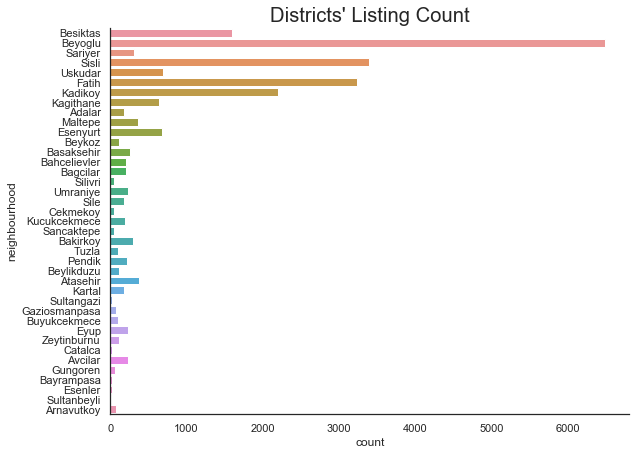

In [96]:
g = sns.catplot(y = 'neighbourhood', kind = 'count', palette = None, height = 6, aspect = 1.5, data = ist);
g.savefig('neighbourhood_count.png', dpi = 800)
plt.style.use('fivethirtyeight')
plt.title("Districts' Listing Count")

Most popular districts are Beyoglu, Sisli, Fatih, Kadikoy and Besiktas. All of them are very central and very close to touristic areas. We can suspect that being near to popular places is an important factor for Airbnb rentals. We will seek this question in further.

Listings colored by neighbourhood on a basic map :

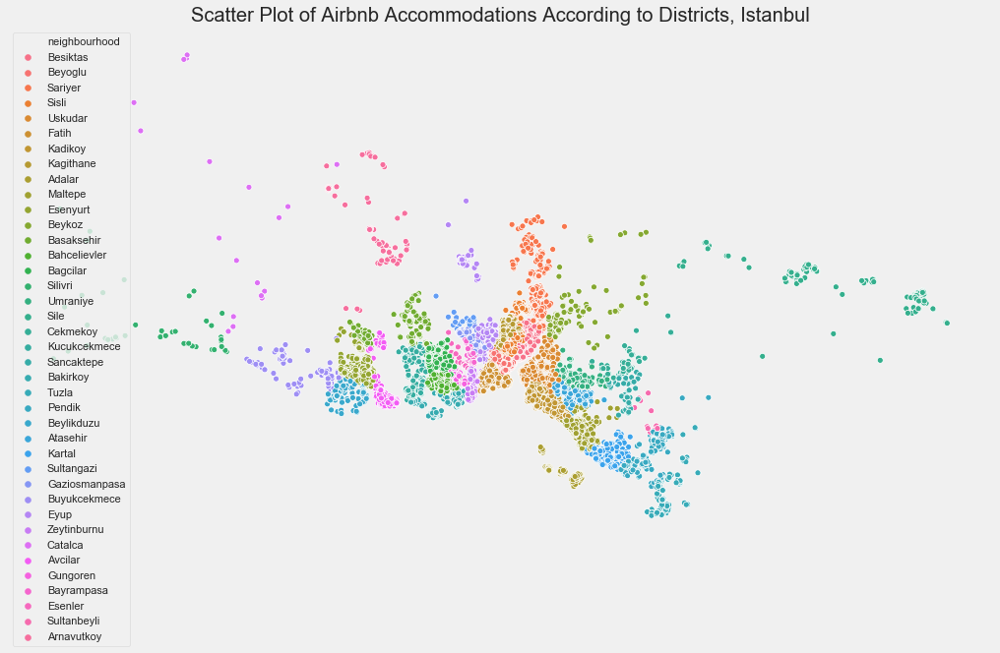

In [97]:
fig = plt.figure(figsize=(16,9))
plt.style.use('fivethirtyeight')
sns.scatterplot(x = 'longitude', y = 'latitude', data = ist, hue = 'neighbourhood')
plt.xlabel('')
plt.xticks([])
plt.ylabel('')
plt.yticks([])
plt.title('Scatter Plot of Airbnb Accommodations According to Districts, Istanbul')
plt.show()
fig.savefig('istanbul_by_districts.png', dpi = 1600)

Let's find latitude and longitude centers for Folium map.

In [98]:
ist.latitude.describe()

count    23650.000000
mean        41.028735
std          0.046421
min         40.813370
25%         41.005090
50%         41.031610
75%         41.048370
max         41.483730
Name: latitude, dtype: float64

In [99]:
ist.longitude.describe()

count    23650.000000
mean        28.982172
std          0.128478
min         28.018990
25%         28.972790
50%         28.982740
75%         29.012922
max         29.908960
Name: longitude, dtype: float64

### Heatmap According to Listing Count

In [100]:
map_folium = folium.Map([41.028735,28.982172],zoom_start=10.4)
HeatMap(ist[['latitude','longitude']].dropna(),radius=8,gradient={0.2:'blue',0.4:'purple',0.6:'orange',1.0:'red'}).add_to(map_folium)
display(map_folium)

### WordCloud

There are 10904240 words in the combination of all review.


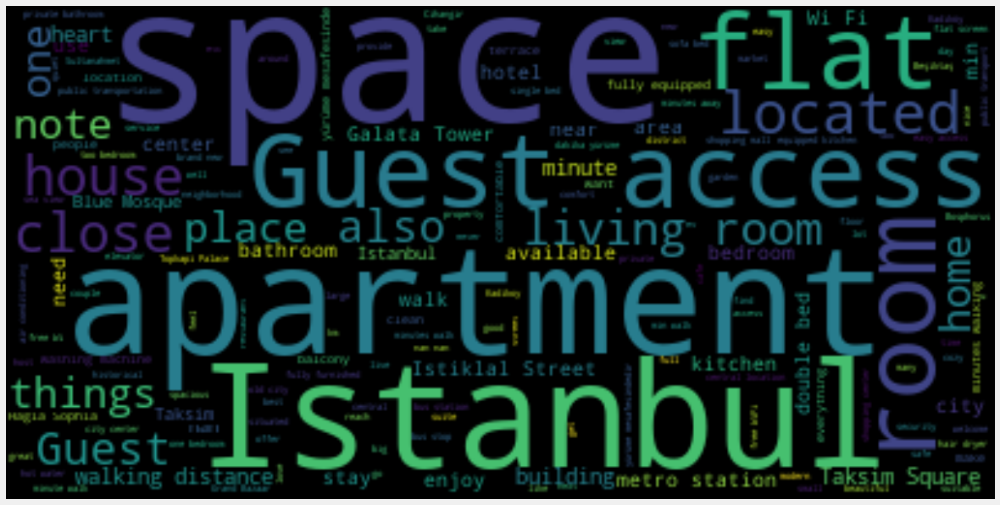

In [101]:
import nltk
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
text = " ".join(str(description) for description in ist.description)
stop_word_list1 = nltk.corpus.stopwords.words('turkish')
stop_word_list2 = nltk.corpus.stopwords.words('english')
stop_word_list1.extend(stop_word_list2)
stop_word_list1.append("br")
stop_word_list1.append("b")
stop_word_list1.append("thing")
print ("There are {} words in the combination of all review.".format(len(text)))
# Generate a word cloud image
wordcloud = WordCloud(stopwords=stop_word_list1, background_color="black").generate(text)

# Display the generated image:
# the matplotlib way:
plt.figure(figsize=(20,10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()
wordcloud.to_file("wordcloud_istanbul.png")

##  3. Data Analyses - Answering the Questions

## QUESTION 1

### In which districts shared houses are popular? 
### In which districts hotels are more common in listings?
### In which districts shared houses are unpopular? 

In [102]:
ist.room_type.value_counts()

Entire home/apt    11996
Private room       10181
Hotel room           821
Shared room          652
Name: room_type, dtype: int64

Text(0.5, 1, 'Room Type Count')

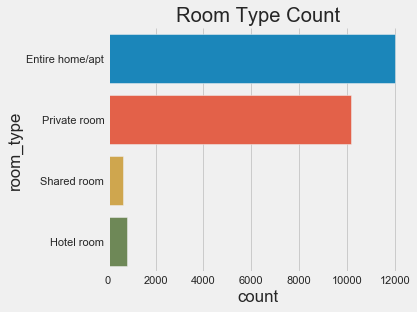

In [103]:
g = sns.catplot(y = 'room_type', kind = 'count', palette = None, height = 4, aspect = 1.5, data = ist);
g.savefig('room_type.png', dpi = 800)
plt.title("Room Type Count")

In [104]:
def create_scatter_plot_map(df,hue_column,map_source):
    '''Takes a df and column and base map,  returns a geomap accord to latitude and longitude values'''
    fig = plt.figure(figsize=(16,9))
    #plot the base map
    nyc_img = plt.imread(map_source, 0)
    plt.imshow(nyc_img, extent = [28.747, 29.175, 40.89, 41.159])
    #make passive on autoscale
    plt.autoscale(False)
    
    #draw a scatterplot with longitude and latitude values for dataframe
    g = sns.scatterplot(x = 'longitude', y = 'latitude', data = df, hue = hue_column)
    g.set(ylim=(40.89, 41.159))
    g.set(xlim=(28.747, 29.175))
    plt.xlabel('')
    plt.xticks([])
    plt.ylabel('')
    plt.yticks([])
    plt.title("Scatter Plot of Airbnb Accommodations According to "+ str(hue_column) +"s, Istanbul")
    plt.show()

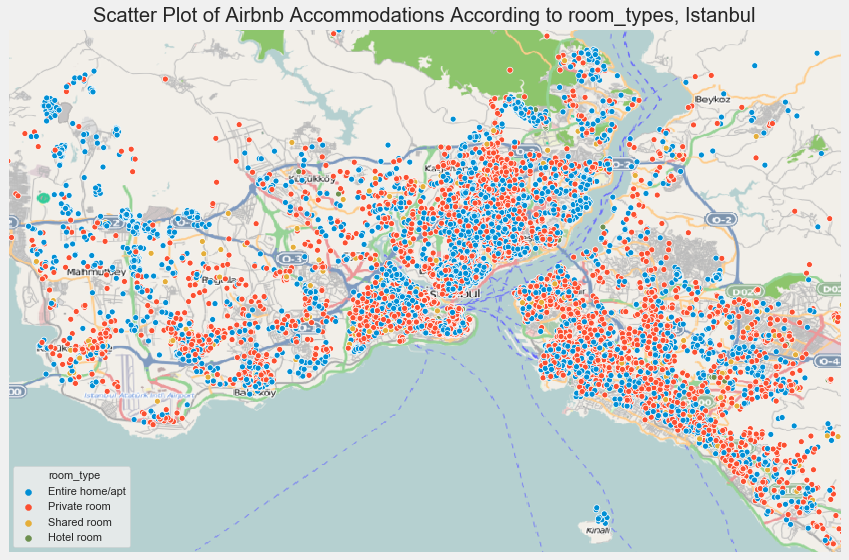

In [105]:
create_scatter_plot_map(ist,"room_type",'Location_map_Istanbul.png')

fig = plt.figure(figsize=(16,9))

nyc_img = plt.imread('Location_map_Istanbul.png', 0)
plt.imshow(nyc_img, extent = [28.747, 29.175, 40.89, 41.159])
plt.autoscale(False)

g = sns.scatterplot(x = 'longitude', y = 'latitude', data = ist, hue = 'room_type')
g.set(ylim=(40.89, 41.159))
g.set(xlim=(28.747, 29.175))
plt.xlabel('')
plt.xticks([])
plt.ylabel('')
plt.yticks([])
plt.title('Scatter Plot of Airbnb Accommodations According to Room Types, Istanbul')
plt.show()

fig.savefig('istanbul_room_type.png', dpi = 1600)

In [106]:
df = ist.groupby(["neighbourhood","room_type"]).size().unstack('room_type', fill_value=0)
df["total_listings"] = df["Hotel room"] + df["Private room"]+df["Entire home/apt"] + df["Shared room"]
df["shared_house_rate"] = ( df["Shared room"] + df["Private room"] ) / (df["Hotel room"] + df["Private room"]+df["Entire home/apt"]+df["Shared room"])
df["hotel_rate"] = ( df["Hotel room"] ) / (df["Hotel room"] + df["Private room"]+df["Entire home/apt"]+df["Shared room"])
df["entire_home_rate"] = ( df["Entire home/apt"] ) / (df["Hotel room"] + df["Private room"]+df["Entire home/apt"]+df["Shared room"])

Let's answer the 1st question.

In [107]:
df1 = df[df.total_listings >= 50].sort_values(by=["shared_house_rate"],ascending=False)
df1.head(10)

room_type,Entire home/apt,Hotel room,Private room,Shared room,total_listings,shared_house_rate,hotel_rate,entire_home_rate
neighbourhood,,,,,,,,
Uskudar,199,2,464,29,694,0.710375,0.002882,0.286744
Bahcelievler,68,2,127,11,208,0.663462,0.009615,0.326923
Gungoren,22,1,44,0,67,0.656716,0.014925,0.328358
Maltepe,130,3,216,16,365,0.635616,0.008219,0.356164
Sancaktepe,20,0,26,6,52,0.615385,0.000000,0.384615
Kadikoy,826,27,1278,66,2197,0.611743,0.012289,0.375967
Pendik,83,4,121,15,223,0.609865,0.017937,0.372197
Arnavutkoy,33,0,47,2,82,0.597561,0.000000,0.402439
Cekmekoy,22,0,29,2,53,0.584906,0.000000,0.415094


We will exclude districts which have less than 50 listings. 
We can clearly see that Uskudar, Bahcelievler, Gungoren, Maltepe and Kadıkoy have high rates of shared house listings. Since these areas have higher rental prices for local people too, hosts tend to rent homes not fully but partly. This may help them make more profit.

In [108]:
df2= df[df.total_listings >= 50].sort_values(by=["hotel_rate"],ascending=False)
df2.head(10)

room_type,Entire home/apt,Hotel room,Private room,Shared room,total_listings,shared_house_rate,hotel_rate,entire_home_rate
neighbourhood,,,,,,,,
Fatih,1184,340,1621,84,3229,0.528027,0.105296,0.366677
Bakirkoy,113,19,144,20,296,0.554054,0.064189,0.381757
Buyukcekmece,68,6,27,3,104,0.288462,0.057692,0.653846
Adalar,116,9,58,2,185,0.324324,0.048649,0.627027
Atasehir,194,17,150,13,374,0.435829,0.045455,0.518717
Kartal,81,8,85,9,183,0.513661,0.043716,0.442623
Beyoglu,4010,211,2126,133,6480,0.348611,0.032562,0.618827
Sile,111,5,65,0,181,0.359116,0.027624,0.613260
Kagithane,262,17,334,29,642,0.565421,0.026480,0.408100


Fatih is the most touristic district in Istanbul. Seeing highest hotel rate in this district is not surprising.

In [109]:
df3= df[df.total_listings >= 50].sort_values(by=["shared_house_rate"],ascending=True)
df3.head(10)

room_type,Entire home/apt,Hotel room,Private room,Shared room,total_listings,shared_house_rate,hotel_rate,entire_home_rate
neighbourhood,,,,,,,,
Basaksehir,216,0,41,0,257,0.159533,0.000000,0.840467
Bagcilar,156,1,47,8,212,0.259434,0.004717,0.735849
Esenyurt,482,3,173,23,681,0.287812,0.004405,0.707783
Buyukcekmece,68,6,27,3,104,0.288462,0.057692,0.653846
Adalar,116,9,58,2,185,0.324324,0.048649,0.627027
Gaziosmanpasa,49,1,24,0,74,0.324324,0.013514,0.662162
Beyoglu,4010,211,2126,133,6480,0.348611,0.032562,0.618827
Sile,111,5,65,0,181,0.359116,0.027624,0.613260
Beylikduzu,74,0,38,4,116,0.362069,0.000000,0.637931


Basaksehir, Bagcilar and Esenyurt has lowest "shared house rate". In this areas sharing a home seems not popular.

## QUESTION 2

### What are the top districts for review value score?

(0, 20)

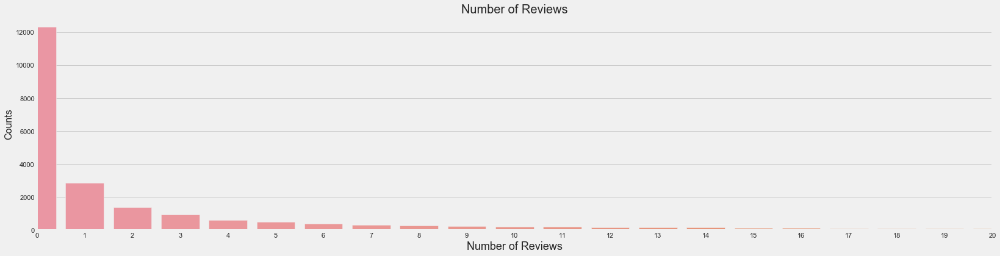

In [110]:
sns.countplot(ist['number_of_reviews'])
fig = plt.gcf()
plt.style.use('fivethirtyeight')
fig.set_size_inches(25, 6)
plt.title('Number of Reviews',fontsize=20)
plt.xlabel('Number of Reviews', fontsize=18)
plt.ylabel('Counts', fontsize=16)
plt.xlim(0,20)

Most listings have zero reviews. For these question, we will evaluate only accommodations which have reviews.

In [111]:
ist[ist.review_scores_value.notnull()]["review_scores_value"].describe()

count    10865.000000
mean         4.590152
std          0.725638
min          1.000000
25%          4.500000
50%          5.000000
75%          5.000000
max          5.000000
Name: review_scores_value, dtype: float64

10865 listing have review value score, mean value is 4.59. Lets see distribution for this column:

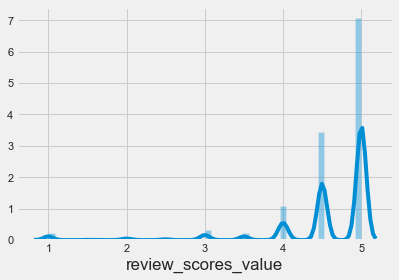

In [112]:
sns.distplot(ist[(ist.review_scores_value.notnull())]["review_scores_value"])

In [113]:
ist[ist.review_scores_value.notnull()].groupby("neighbourhood").agg({"review_scores_value": [ "mean","count"]}).reset_index().sort_values(by=[("review_scores_value","mean")],ascending=False).head(15)

neighbourhood review_scores_value      
                                mean count
28    Sancaktepe            5.000000     8
34    Sultangazi            5.000000     4
16       Esenler            4.916667    12
31       Silivri            4.781250    16
10        Beykoz            4.731707    41
37       Uskudar            4.709091   220
36      Umraniye            4.707792    77
26       Maltepe            4.704000   125
22       Kadikoy            4.694471  1031
5   Bahcelievler            4.678082    73
4       Bagcilar            4.661972    71
9       Besiktas            4.661832   655
0         Adalar            4.648760   121
25  Kucukcekmece            4.642857    49
2       Atasehir            4.620253   158

We can state that Uskudar, Umraniye, Maltepe and Kadıkoy have highest review value score for districts which have more than 50 listings with reviews.

## QUESTION 3

### Is price range distribution different for top 5 districts? Is it statistically significant?

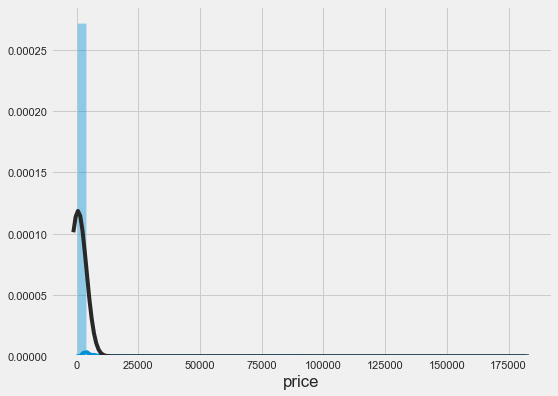

In [114]:
plt.figure(figsize=(8,6))
plt.style.use('fivethirtyeight')
sns.distplot(ist['price'],fit=norm)

Text(0.5, 0, 'log-price')

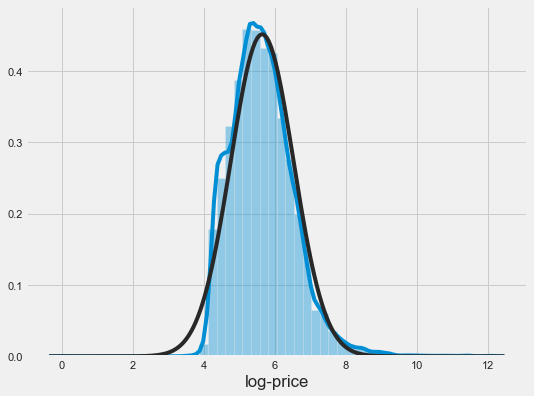

In [115]:
plt.figure(figsize=(8,6))
plt.style.use('fivethirtyeight')
sns.distplot(np.log1p(ist[ist.price.notnull()]['price']),fit=norm)
plt.xlabel("log-price")

Limit price to 1000 TL max and check the distribution again:

(0, 1000)

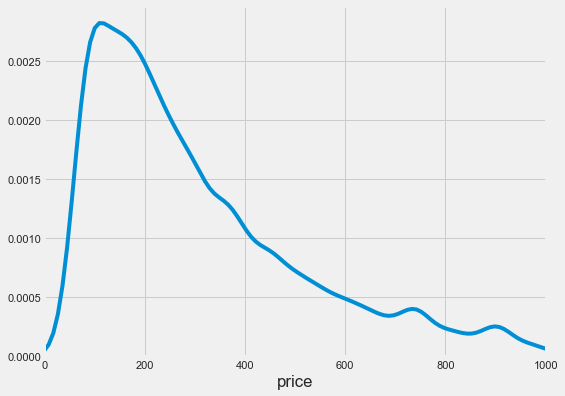

In [116]:
plt.figure(figsize=(8,6))
plt.style.use('fivethirtyeight')
sns.distplot(ist[ist.price <1000].price,hist=False)
plt.xlim(0,1000)

Lets have a look on top 5 expensive place. If we check website with rent id's we can easily see that there are some data or host mistakes for these prices.

In [117]:
ist.sort_values(by=["price"],ascending=False).head()

,id,host_id,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,calculated_host_listings_count,availability_365,description,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value
4044,16111771,91054410,Fatih,41.002450,28.973780,Private room,181891,1,1,4,365,"Mekanım şuraya yakın: Mozaik Müzesi, Küçük Aya...",40.0,4.0,2.0,4.0,4.0,4.0,2.0
4043,16111705,91054410,Fatih,41.003810,28.975420,Private room,181726,1,0,4,3,"Mekanım şuraya yakın: Küçük Ayasofya, Kumkapı ...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
3808,14658972,91054410,Fatih,41.003980,28.975220,Private room,181691,1,6,4,365,"stone throw away from Blue Mosque , St Sophia ...",93.0,9.0,4.5,4.5,5.0,5.0,4.5
4092,16401723,91054410,Fatih,41.005370,28.976520,Private room,181495,1,1,4,354,"Mekanım şuraya yakın: Sultan Ahmet Camii, İsta...",100.0,10.0,5.0,5.0,5.0,5.0,5.0
20480,45537032,368666184,Fatih,41.009901,28.977268,Private room,150573,1,0,1,365,"Situated only 1 km from the city center, guest...",NaN,NaN,NaN,NaN,NaN,NaN,NaN


It seems like we have outlier values.

In [118]:
ist.price.describe()

count     23650.000000
mean        548.576152
std        3364.154723
min           0.000000
25%         150.000000
50%         260.000000
75%         472.000000
max      181891.000000
Name: price, dtype: float64

### Find the outliers with 2 standart deviations from mean and exclude them from price analysis.

In [119]:
from numpy import mean
from numpy import std

# calculate summary statistics
data_mean, data_std = mean(ist.price), std(ist.price)
# identify outliers
cut_off = data_std * 2
lower, upper = data_mean - cut_off, data_mean + cut_off
# identify outliers
outliers = [x for x in ist.price if x < lower or x > upper]
print('Identified outliers: %d' % len(outliers))
# remove outliers
outliers_removed = [x for x in ist.price if x >= lower and x <= upper]
print('Non-outlier observations: %d' % len(outliers_removed))
print('Lower and upper bounds: %d' % lower , upper)

Identified outliers: 107
Non-outlier observations: 23543
Lower and upper bounds: -6179 7276.743349707978


In [120]:
ist[(ist.price >= lower)&(ist.price <= upper)].shape

(23543, 19)

### Create a dataframe by excluding outlier points 

In [121]:
ist_price_95 = ist[(ist.price > lower)&(ist.price < upper)].copy()

In [122]:
# create a LinearColorMap and assign colors, vmin, and vmax
colormap = cm.LinearColormap(colors=['green', 'yellow', 'red'], vmin=ist_price_95.price.min(), vmax=ist_price_95.price.max())

m = folium.Map(location=[41.028735,28.982172] , zoom_start=11.4)

# go through each rentals in set, make circle, and add to map.
for i in range(len(ist_price_95)):
    folium.Circle(
        location=[ist_price_95.iloc[i]['latitude'], ist_price_95.iloc[i]['longitude']],
        radius=10, color=colormap(ist_price_95.iloc[i]['price'])).add_to(m)

m.add_child(colormap)
display(m)

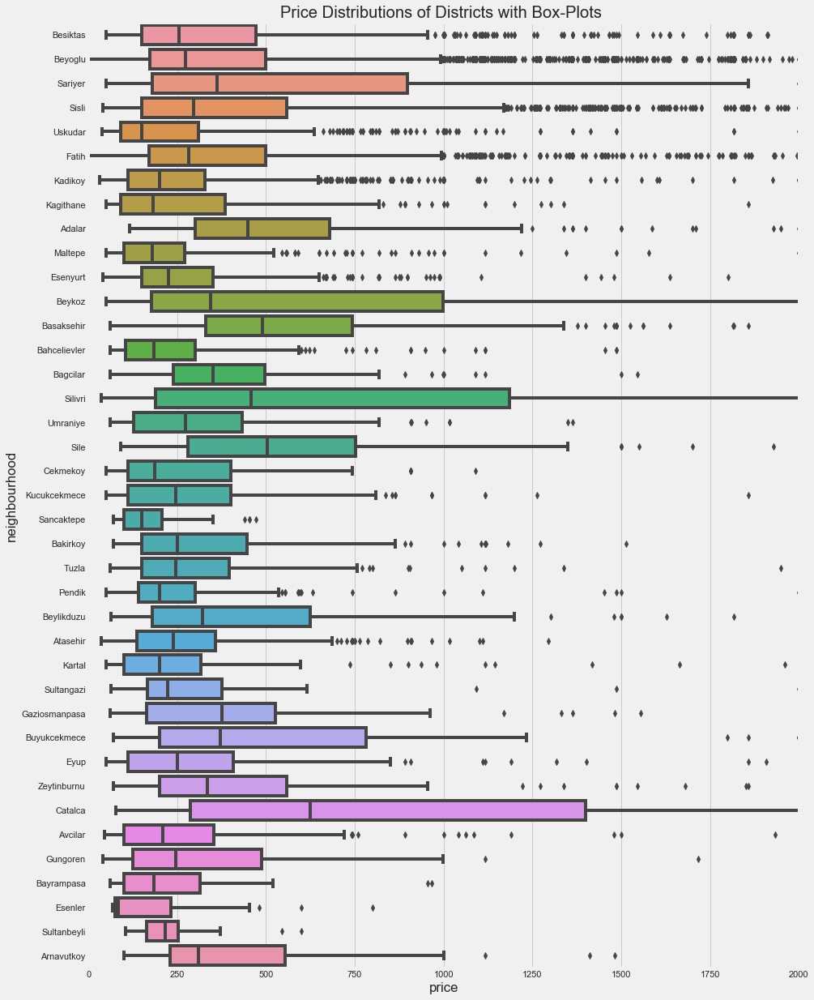

In [123]:
plt.style.use('fivethirtyeight')
plt.figure(figsize=(14,20))
sns.boxplot(y='neighbourhood',x='price',data = ist_price_95)
plt.title('Price Distributions of Districts with Box-Plots ')
plt.xlim((0,2000))
plt.show()

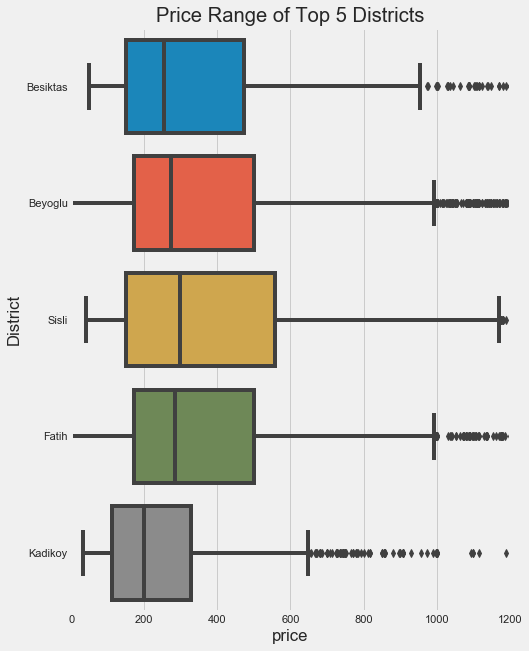

In [124]:
top_districts = ["Beyoglu","Sisli","Fatih","Kadikoy","Besiktas"]
plt.style.use('fivethirtyeight')
plt.figure(figsize=(7,10))
sns.boxplot(y='neighbourhood',x='price',data = ist_price_95[ist_price_95.neighbourhood.isin(top_districts)])
plt.title('Price Range of Top 5 Districts')
plt.ylabel("District")
plt.xlim((0,1200))
plt.show()

### ANOVA Test to see there is a difference for district means in top districts.

H0 (null hypothesis): mean_price(Besiktas) = mean_price(Beyoglu) = mean_price(Sisli)= mean_price(Fatih) = mean_price(Kadikoy)

H1 (alternate hypothesis): mean_price(Besiktas) != mean_price(Beyoglu) != mean_price(Sisli)!= mean_price(Fatih) != mean_price(Kadikoy)

In [125]:
import scipy.stats as st

In [126]:
besiktas = ist_price_95[ist_price_95['neighbourhood'] == 'Besiktas']
beyoglu = ist_price_95[ist_price_95['neighbourhood'] == 'Beyoglu']
sisli = ist_price_95[ist_price_95['neighbourhood'] == 'Sisli']
fatih = ist_price_95[ist_price_95['neighbourhood'] == 'Fatih']
kadikoy = ist_price_95[ist_price_95['neighbourhood'] == 'Kadikoy']

In [127]:
st.f_oneway(besiktas.price,beyoglu.price,sisli.price,fatih.price,kadikoy.price)

F_onewayResult(statistic=55.190455412134725, pvalue=2.59956704712537e-46)

We can clearly state that at least one district is different than others. P value is less than alpha=0.05 and null hypthesis is rejected.

In [128]:
ist_price_95['price_range'] = pd.qcut(ist_price_95['price'], q=5)

In [129]:
ist_price_95.price_range.value_counts()

(-0.001, 133.0]    4729
(133.0, 210.0]     4724
(210.0, 320.0]     4706
(545.0, 7276.0]    4693
(320.0, 545.0]     4691
Name: price_range, dtype: int64

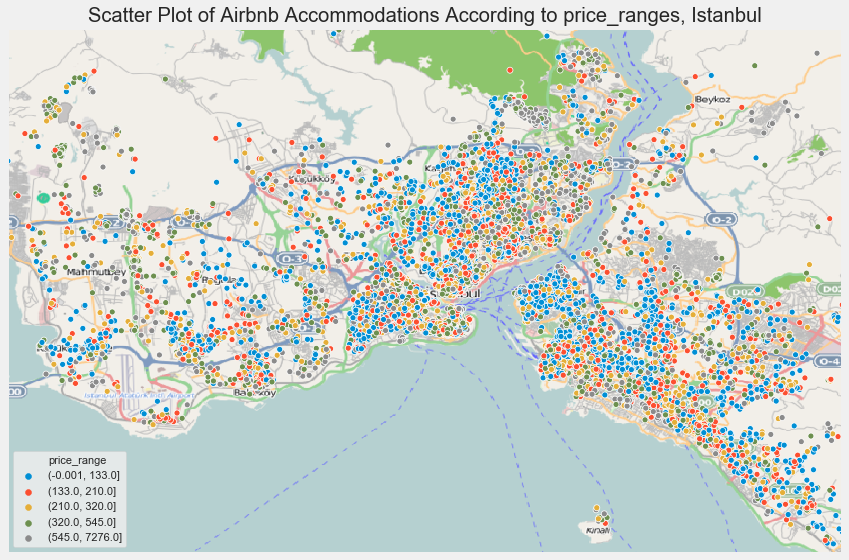

In [130]:
create_scatter_plot_map(ist_price_95,"price_range",'Location_map_Istanbul.png')

## QUESTION 4

### Does continent  makes a difference in price range?

In [131]:
europe = ['Beyoglu','Sisli','Fatih','Besiktas','Sariyer', 'Kucukcekmece',  'Bagcilar', 
        'Zeytinburnu', 'Buyukcekmece', 'Beylikduzu',
        'Arnavutkoy', 'Gaziosmanpasa', 'Gungoren',
        'Silivri', 'Esenler', 'Bayrampasa', 'Catalca',
       'Sultangazi','Beyoglu', 'Sisli', 'Fatih', 'Besiktas', 
       'Esenyurt', 'Kagithane',   'Sariyer',
       'Bakirkoy', 'Basaksehir', 'Avcilar',  'Eyup', 
       'Bahcelievler' ]

asia = ['Pendik','Umraniye','Sile','Adalar','Kartal',
              'Beykoz','Tuzla','Sancaktepe','Sultanbeyli','Kadikoy','Uskudar','Maltepe','Atasehir',
               'Cekmekoy','Kadikoy','Uskudar','Beykoz']

In [132]:
ist_price_95.loc[ist_price_95['neighbourhood'].isin(europe),'continent'] = 'europe'
ist_price_95.loc[ist_price_95['neighbourhood'].isin(asia),'continent'] = 'asia'

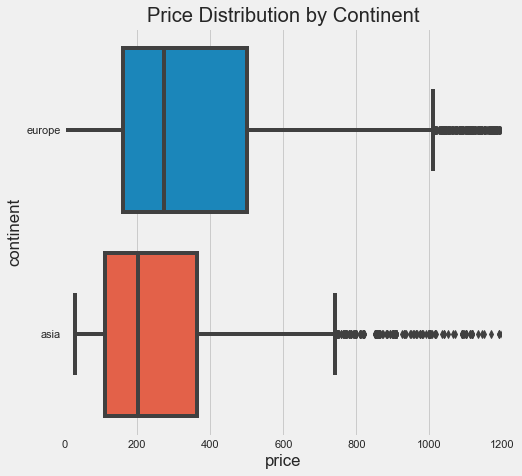

In [133]:
plt.style.use('fivethirtyeight')
plt.figure(figsize=(7,7))
sns.boxplot(y='continent',x='price',data = ist_price_95)
plt.title('Price Distribution by Continent')
plt.xlim((0,1200))
plt.show()

We can use ANOVA test for two groups too. T-test is used generally for two groups but since t-test is a special version of ANOVA , we may use ANOVA again this analysis too.

In [134]:
europe = ist_price_95[ist_price_95['continent'] == 'europe']
asia = ist_price_95[ist_price_95['continent'] == 'asia']

H0 (null hypothesis): mean_price(europe) = mean_price(asia) 

H1 (alternate hypothesis): mean_price(europe) != mean_price(asia) 

In [135]:
st.f_oneway(europe.price,asia.price)

F_onewayResult(statistic=148.94967398536176, pvalue=3.7307926265115452e-34)

P value is below the alpha=0.05. Therefore we can reject the null hypothesis and accept H1 hypothesis.
Europe side seems more expensive for renters statistically.

## QUESTION 5

### Is distance to touristic areas effecting the price?

In [136]:
touristic_places = {"Blue Mosque":[(41.005550,28.976597)],"Hagia Sophia":[(41.008189,28.979282)],
                        "Galata Tower":[(41.025548, 28.974268)], "Topkapi Palace":[(41.011326, 28.983200)],
                         "Taksim":[(41.0370,28.9851)],"Grand Bazaar":[(41.0107,28.9681)],"Besiktas":[(41.0422,29.0067)],
                          "Kadikoy":[(40.9819, 29.0576)]}

In [137]:
touristic_places["Blue Mosque"][0]

(41.00555, 28.976597)

In [138]:
touristic_places["Blue Mosque"][0][1]

28.976597

In [139]:
touristic_places.keys()

dict_keys(['Blue Mosque', 'Hagia Sophia', 'Galata Tower', 'Topkapi Palace', 'Taksim', 'Grand Bazaar', 'Besiktas', 'Kadikoy'])

In [140]:
ist_price_95.head()

,id,host_id,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,calculated_host_listings_count,...,description,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,price_range,continent
0,20815,78838,Besiktas,41.06984,29.04545,Entire home/apt,891,365,41,2,...,Watch The Bosphorus from The Comfy Hill.<br />...,90.0,9.0,4.5,5.0,5.0,5.0,4.5,"(545.0, 7276.0]",europe
1,27271,117026,Beyoglu,41.03254,28.98153,Entire home/apt,273,30,10,1,...,This is a nicely decorated apartment in an an...,98.0,10.0,4.5,5.0,5.0,5.0,5.0,"(210.0, 320.0]",europe
2,28318,121721,Sariyer,41.09048,29.05559,Entire home/apt,930,3,0,1,...,<b>The space</b><br />Easy access to both brid...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"(545.0, 7276.0]",europe
3,29241,125742,Beyoglu,41.04844,28.95254,Private room,372,3,0,1,...,<b>The space</b><br />There are many interesti...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"(320.0, 545.0]",europe
4,30697,132137,Beyoglu,41.03350,28.97626,Private room,908,1,1,1,...,<b>The space</b><br />I can ensure you that th...,80.0,NaN,NaN,NaN,NaN,NaN,NaN,"(545.0, 7276.0]",europe


In [141]:
for i in touristic_places.keys():
    ist_price_95["distance_to_"+str(i)] = ist_price_95.apply(lambda x:geodesic((x["latitude"], 
                    x["longitude"]), touristic_places[i][0]).kilometers, axis=1)

In [142]:
ist_price_95['minimum_distance'] = ist_price_95[['distance_to_Hagia Sophia','distance_to_Blue Mosque',
                             'distance_to_Galata Tower', "distance_to_Topkapi Palace","distance_to_Grand Bazaar",
                              'distance_to_Taksim',"distance_to_Kadikoy","distance_to_Besiktas"]].min(axis=1).round(2)

In [143]:
ist_price_95.head()

,id,host_id,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,calculated_host_listings_count,...,continent,distance_to_Blue Mosque,distance_to_Hagia Sophia,distance_to_Galata Tower,distance_to_Topkapi Palace,distance_to_Taksim,distance_to_Grand Bazaar,distance_to_Besiktas,distance_to_Kadikoy,minimum_distance
0,20815,78838,Besiktas,41.06984,29.04545,Entire home/apt,891,365,41,2,...,europe,9.192142,8.822240,7.746633,8.344110,6.248271,9.243175,4.475863,9.819437,4.48
1,27271,117026,Beyoglu,41.03254,28.98153,Entire home/apt,273,30,10,1,...,europe,3.025937,2.710885,0.987888,2.360090,0.579179,2.675559,2.372844,8.519390,0.58
2,28318,121721,Sariyer,41.09048,29.05559,Entire home/apt,930,3,0,1,...,europe,11.535462,11.165808,9.936312,10.691560,8.389262,11.515212,6.755307,12.059494,6.76
3,29241,125742,Beyoglu,41.04844,28.95254,Private room,372,3,0,1,...,europe,5.175012,5.003927,3.130698,4.861734,3.018101,4.390723,4.606067,11.519624,3.02
4,30697,132137,Beyoglu,41.03350,28.97626,Private room,908,1,1,1,...,europe,3.104097,2.822364,0.898854,2.530752,0.838846,2.623404,2.735890,8.925285,0.84


In [144]:
ist_price_95['price'].corr(ist_price_95['minimum_distance'])

0.0689601801915348

Create a categorical variable based on minimum distance. We will divide feature's value to 5 bins and name these categories.

In [145]:
names = ['very close', 'close', 'middle', 'far', 'very far']
ist_price_95['distance_category'] = pd.qcut(ist_price_95['minimum_distance'], 5, labels=names)

In [146]:
ist_price_95.head()

,id,host_id,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,calculated_host_listings_count,...,distance_to_Blue Mosque,distance_to_Hagia Sophia,distance_to_Galata Tower,distance_to_Topkapi Palace,distance_to_Taksim,distance_to_Grand Bazaar,distance_to_Besiktas,distance_to_Kadikoy,minimum_distance,distance_category
0,20815,78838,Besiktas,41.06984,29.04545,Entire home/apt,891,365,41,2,...,9.192142,8.822240,7.746633,8.344110,6.248271,9.243175,4.475863,9.819437,4.48,far
1,27271,117026,Beyoglu,41.03254,28.98153,Entire home/apt,273,30,10,1,...,3.025937,2.710885,0.987888,2.360090,0.579179,2.675559,2.372844,8.519390,0.58,close
2,28318,121721,Sariyer,41.09048,29.05559,Entire home/apt,930,3,0,1,...,11.535462,11.165808,9.936312,10.691560,8.389262,11.515212,6.755307,12.059494,6.76,far
3,29241,125742,Beyoglu,41.04844,28.95254,Private room,372,3,0,1,...,5.175012,5.003927,3.130698,4.861734,3.018101,4.390723,4.606067,11.519624,3.02,far
4,30697,132137,Beyoglu,41.03350,28.97626,Private room,908,1,1,1,...,3.104097,2.822364,0.898854,2.530752,0.838846,2.623404,2.735890,8.925285,0.84,close


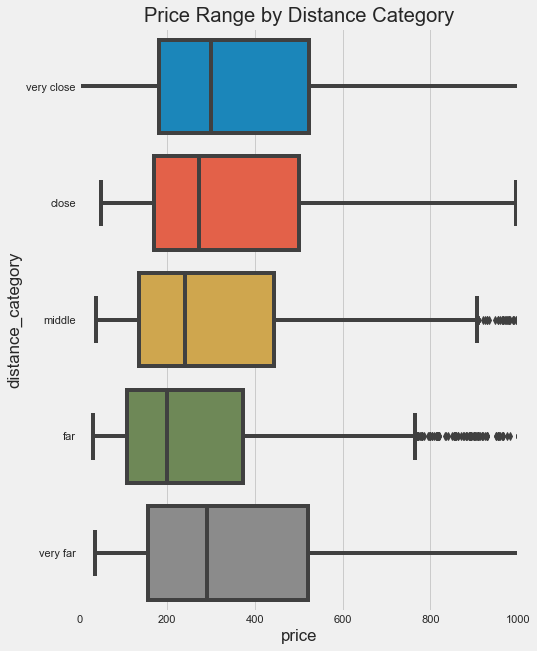

In [147]:
plt.style.use('fivethirtyeight')
plt.figure(figsize=(7,10))
sns.boxplot(y='distance_category',x='price',data = ist_price_95)
plt.title('Price Range by Distance Category')
plt.xlim(0,1000)
plt.show()

In [148]:
very_close = ist_price_95[ist_price_95['distance_category'] == 'very close']
close = ist_price_95[ist_price_95['distance_category'] == 'close']
middle = ist_price_95[ist_price_95['distance_category'] == 'middle']
far = ist_price_95[ist_price_95['distance_category'] == 'far']
very_far = ist_price_95[ist_price_95['distance_category'] == 'very far']

We make an ANOVA test to see a difference for mean price in categories based on distance metric we cakculated.

H0 (null hypothesis): mean_price(very_close) = mean_price(close) = mean_price(middle) = mean_price(far) = mean_price(very_far)

H1 (alternate hypothesis): mean_price(very_close) != mean_price(close) != mean_price(middle) != mean_price(far) != mean_price(very_far)

In [149]:
st.f_oneway(very_close.price, close.price, middle.price, far.price,very_far.price)

F_onewayResult(statistic=80.12287299480033, pvalue=1.1949315780934862e-67)

Since p-value is very less than alpha=0.05 we can conclude that one group's mean price is different than other groups.

## 4. Evaluation - Findings 

* **Beyoglu , Sisli, Fatih, Kadikoy and Besiktas have most listing counts, total listing number of these districts cover 71% of all listings.**


* **Fatih is the most touristic district in Istanbul which have most of the sightseeing places and old mosques. Seeing highest hotel rate in this district is not surprising.**


* **Basaksehir, Bagcilar and Esenyurt have highest "entire hoom rate". In these districts home sharing seems not popular since these areas are more conservative areas.**



* **Uskudar, Umraniye, Maltepe and Kadıkoy have highest review value score for districts which have more than 50 listings.**


* **95% of the daily price values distributed between 0 and 1272 TL.**


* **Besiktas, Beyoglu, Sisli, Fatih and Kadikoy are evaluated with ANOVA test according to their price mean. At least one group has different mean price according to statistical ANOVA test.**


* **Continent has an effect on price according to ANOVA test. Rentals located in Europe tend to have higher daily prices.**


* **Besiktas, Beyoglu, Sisli, Fatih and Kadikoy are evaluated with ANOVA test according to their price mean. At least one group has different mean price according to statistical ANOVA test.**


* **Distances to 8 most touristic places are calculated and min value used for minimum distance feature. Correlation test show no direct correlation. When we assign a category to the locations according to their minimum distance, we can conclude that at least one group's price mean is different than others. This can be linked to minimum distance and distance to touristic areas.**